### Exercises

Our Zillow scenario continues:

As a Codeup data science graduate, you want to show off your skills to the Zillow data science team in hopes of getting an interview for a position you saw pop up on LinkedIn. You thought it might look impressive to build an end-to-end project in which you use some of their Kaggle data to predict property values using some of their available features; who knows, you might even do some feature engineering to blow them away. Your goal is to predict the values of single unit properties using the observations from 2017.

In these exercises, you will run through the stages of exploration as you continue to work toward the above goal.

1. As with encoded vs. unencoded data, we recommend exploring un-scaled data in your EDA process.

1. Make sure to perform a train, validate, test split before and use only your train dataset to explore the relationships between independent variables with other independent variables or independent variables with your target variable.

1. Write a function named plot_variable_pairs that accepts a dataframe as input and plots all of the pairwise relationships along with the regression line for each pair.

1. Write a function named plot_categorical_and_continuous_vars that accepts your dataframe and the name of the columns that hold the continuous and categorical features and outputs 3 different plots for visualizing a categorical variable and a continuous variable.

1. Save the functions you have written to create visualizations in your explore.py file. Rewrite your notebook code so that you are using the functions imported from this file.

1. Use the functions you created above to explore your Zillow train dataset in your explore.ipynb notebook.

1. Come up with some initial hypotheses based on your goal of predicting property value.

1. Visualize all combinations of variables in some way.

1. Run the appropriate statistical tests where needed.

1. What independent variables are correlated with the dependent variable, home value?

1. Which independent variables are correlated with other independent variables (bedrooms, bathrooms, year built, square feet)?

1. Make sure to document your takeaways from visualizations and statistical tests as well as the decisions you make throughout your process.

1. Explore your dataset with any other visualizations you think will be helpful.

#### Bonus Exercise

In a seperate notebook called explore_mall, use the functions you have developed in this exercise with the mall_customers dataset in the Codeup database server. You will need to write a sql query to acquire your data. Make spending_score your target variable.

In [13]:
from wrangle import *
sns.set_palette("bright")


In [14]:
df=prep_zillow_2017(1.25)



Number of observations removed: 471854
This is our percent change after removing all the outliers and then the nulls:
 -22.02%
mean kurt:
-0.2173658225527361


None

In [15]:
cols=set(df.columns.to_list())

nums=cols-{
'fips',                          
'bedroomcnt',                   
'bathroomcnt',
'decade',
'yearbuilt'}

cats=cols-nums

cat_2_combs=list(combinations(cats,2))
num_2_combs=list(combinations(nums,2))
cat_3_combs=list(combinations(cats,3))
num_3_combs=list(combinations(nums,3))
cat_v_num=set(product(cats,nums))

num_v_cat=set(product(nums,cats))



cols=list(cols)
cats=list(cats)
nums=list(nums)


cat_2_combs=list(cat_2_combs)
num_2_combs=list(num_2_combs)
cat_3_combs=list(cat_3_combs)
# num_3_combs=list(num_3_combs)
cat_v_num=list(cat_v_num)
num_v_cat=list(num_v_cat)
cat_v_2num=set(product(cats,num_2_combs[0],num_2_combs[1]))
cat_v_3num=list(product(cats,num_3_combs[0]))
num_v_2cat=set(product(nums,cat_2_combs[0],cat_2_combs[1]))
num_v_3cat=set(product(nums,cat_3_combs[0],cat_3_combs[1],cat_3_combs[2]))


num_v_2cat=list(num_v_2cat)
num_v_3cat=list(num_v_3cat)

cat_v_2num=list(cat_v_2num)
cat_v_3num=list(cat_v_3num)

l=[
cols,
cats,
nums,
cat_2_combs,
num_2_combs,
cat_3_combs,
num_3_combs,
cat_v_num,
cat_v_2num,
cat_v_3num,
num_v_cat,
num_v_2cat,
num_v_3cat]

In [5]:
for i in l:
    x=len(i)
    print(x)

8
5
3
10
3
10
1
15
20
15
15
12
81


In [6]:
x_train_and_validate, x_test = train_test_split(df, random_state=123)
x_train, x_validate = train_test_split(x_train_and_validate)
df=x_train



In [7]:
cols

['calculatedfinishedsquarefeet',
 'taxamount',
 'yearbuilt',
 'bathroomcnt',
 'fips',
 'bedroomcnt',
 'decade',
 'taxvaluedollarcnt']

Univariate Distributions

Check out the distributions of a single variable at a time using pandas built-in plotting function to create a historgram or Seaborn displot, boxplot, or countplot; this can be done before splitting our data if we want.

Continuous variable distributions

array([[<AxesSubplot:title={'center':'calculatedfinishedsquarefeet'}>,
        <AxesSubplot:title={'center':'taxvaluedollarcnt'}>],
       [<AxesSubplot:title={'center':'taxamount'}>, <AxesSubplot:>]],
      dtype=object)

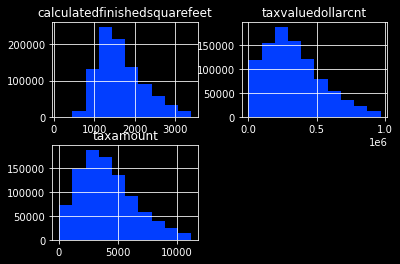

In [8]:
df[nums].hist(grid=True, bins=10)
# sns.displot( x=nums)
# sns.boxplot(df[nums])


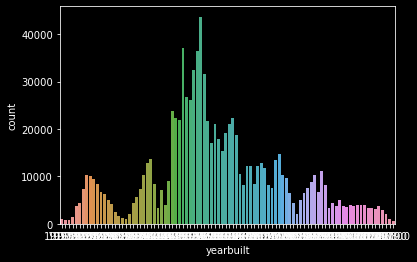

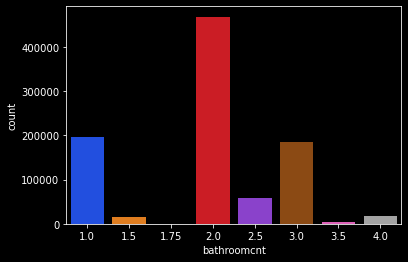

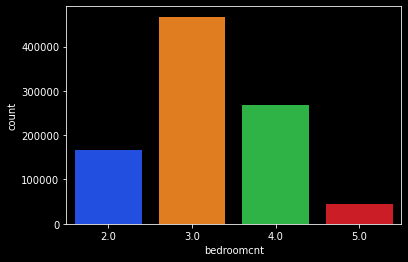

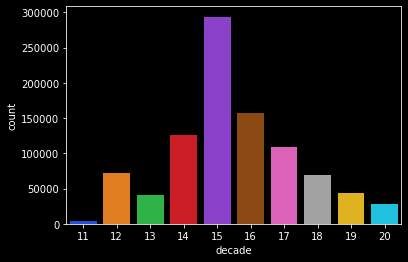

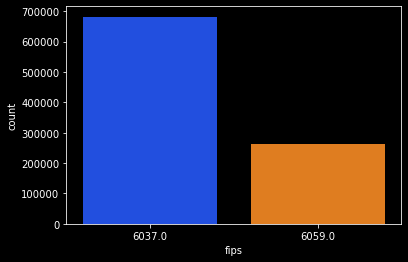

In [9]:
for x in cats:
    sns.countplot(x=x, data=df)
    plt.show()


In [16]:
df=df.sample(frac=(1/128))



In [17]:
df.head()
df.shape

(13116, 8)

Continuous with Continuous

Seaborn pairplot to create a scatter matrix visualizing all continous variable relationships along with individiual distributions.

In [ ]:
# sns.pairplot(data=df[nums])


In [ ]:
# for i in num_2_combs:
#     sns.relplot(x=i[0], y=i[1], data=df, kind='scatter')
#     plt.show()



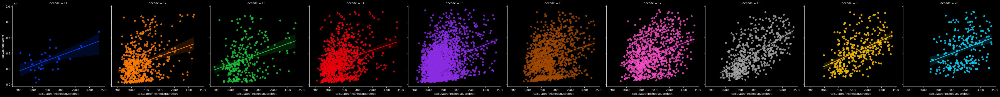

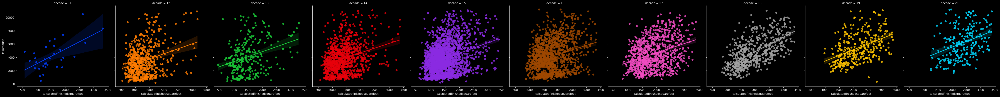

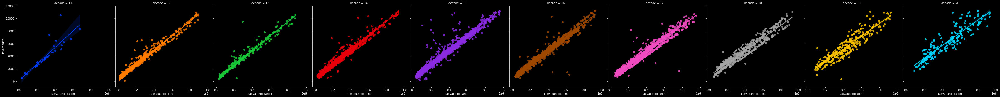

In [12]:
for i in num_2_combs:
    sns.lmplot(x=i[0], y=i[1],ci=95, data=df, scatter=True, hue='decade', col='decade')
    plt.show()


In [ ]:
# for i in num_2_combs:
#     sns.lmplot(x=i[0], y=i[1],ci=95, data=df, scatter=True, hue='fips', col='fips',row='decade',markers='.')
#     plt.show()


In [ ]:

# sns.color_palette("Spectral", as_cmap=True)

# for i in num_2_combs:
#     sns.jointplot(x=i[0], y=i[1], data=df,kind='scatter',hue='decade')
#     plt.show()





In [ ]:
# for i in num_2_combs:
#     sns.jointplot(x=i[0], y=i[1], data=df,kind='hex')
#     plt.show()



/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:1210: UserWarning: No contour levels were found within the data range.
  cset = contour_func(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:1210: UserWarning: No contour levels were found within the data range.
  cset = contour_func(


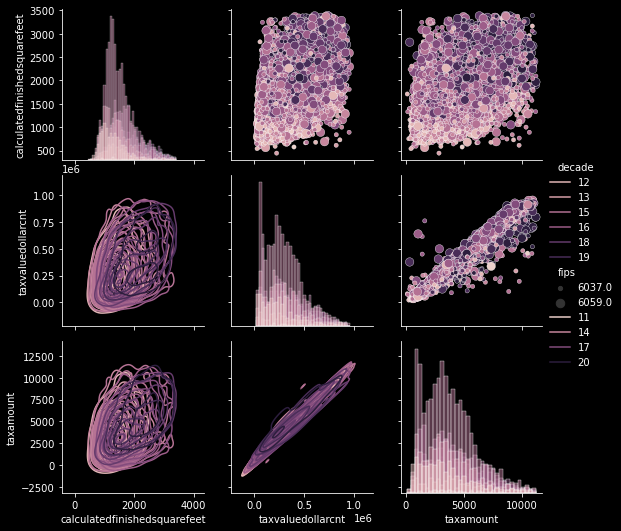

In [11]:

g = sns.PairGrid(df,vars=nums, diag_sharey=False)
g.map_upper(sns.scatterplot,hue=df['decade'],size=df['fips'])
g.map_lower(sns.kdeplot,hue=df['decade'])
g.map_diag(sns.histplot,hue=df['decade'])
g.add_legend(title="", adjust_subtitles=True)

In [36]:
cats
# nums

['yearbuilt', 'bathroomcnt', 'bedroomcnt', 'decade', 'fips']

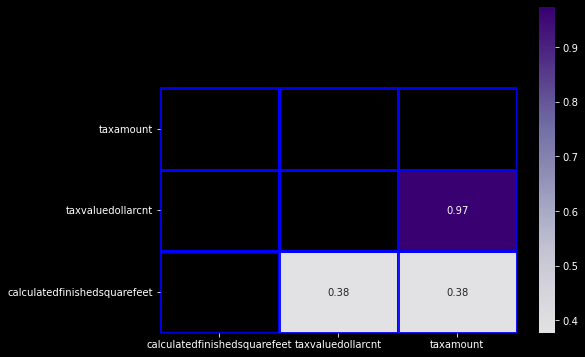

In [18]:
zillow_corr=(df[nums].corr(method='spearman'))
kwargs = {'alpha':.9,'linewidth':3, 'linestyle':'-', 
          'linecolor':'b','rasterized':False, 'edgecolor':'w', 
          'capstyle':'projecting',}


plt.figure(figsize=(8,6))
sns.heatmap(zillow_corr, cmap='Purples', annot=True,  mask= np.tril(zillow_corr),**kwargs)
plt.ylim(0, 4)

plt.show()


In [22]:
cols=set(df.columns.to_list())
cols=cols-{'taxvaluedollarcnt'}
nums=cols-{
'fips',                          
'bedroomcnt',                   
'bathroomcnt',
'decade',
'yearbuilt'}

cats=cols-nums

cat_2_combs=list(combinations(cats,2))
num_2_combs=list(combinations(nums,2))
cat_3_combs=list(combinations(cats,3))
num_3_combs=list(combinations(nums,3))
cat_v_num=set(product(cats,nums))

num_v_cat=set(product(nums,cats))



cols=list(cols)
cats=list(cats)
nums=list(nums)


cat_2_combs=list(cat_2_combs)
num_2_combs=list(num_2_combs)
cat_3_combs=list(cat_3_combs)
# num_3_combs=list(num_3_combs)
cat_v_num=list(cat_v_num)
num_v_cat=list(num_v_cat)
cat_v_2num=set(product(cats,num_2_combs))
# cat_v_3num=list(product(cats,num_3_combs[0]))
num_v_2cat=set(product(nums,cat_2_combs))
num_v_3cat=set(product(nums,cat_3_combs[0],cat_3_combs[1],cat_3_combs[2]))


num_v_2cat=list(num_v_2cat)
num_v_3cat=list(num_v_3cat)

cat_v_2num=list(cat_v_2num)
cat_v_3num=list(cat_v_3num)

l=[
cols,
cats,
nums,
cat_2_combs,
num_2_combs,
cat_3_combs,
num_3_combs,
cat_v_num,
cat_v_2num,
cat_v_3num,
num_v_cat,
num_v_2cat,
num_v_3cat]





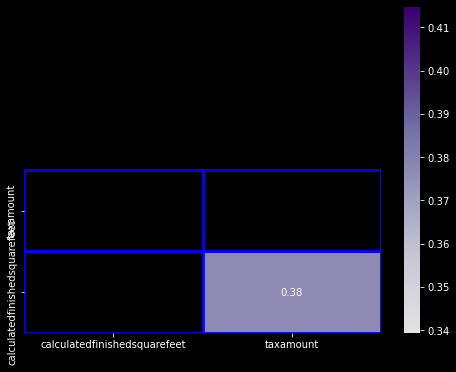

In [28]:
zillow_corr=(df[nums].corr(method='spearman'))
kwargs = {'alpha':.9,'linewidth':3, 'linestyle':'-', 
          'linecolor':'b','rasterized':False, 'edgecolor':'w', 
          'capstyle':'projecting',}


plt.figure(figsize=(8,6))
sns.heatmap(zillow_corr, cmap='Purples', annot=True,  mask= np.tril(zillow_corr),**kwargs)
plt.ylim(0, 4)

plt.show()


/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:1210: UserWarning: No contour levels were found within the data range.
  cset = contour_func(


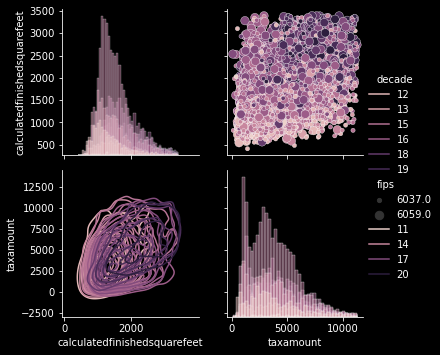

In [29]:


g = sns.PairGrid(df,vars=nums, diag_sharey=False)
g.map_upper(sns.scatterplot,hue=df['decade'],size=df['fips'])
g.map_lower(sns.kdeplot,hue=df['decade'])
g.map_diag(sns.histplot,hue=df['decade'])
g.add_legend(title="", adjust_subtitles=True)



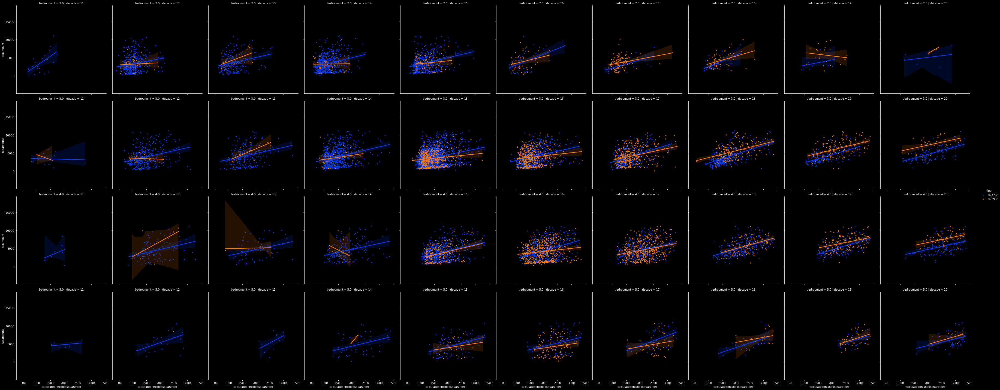

In [38]:
for i in num_2_combs:
    sns.lmplot(x=i[0], y=i[1],ci=95, data=df, scatter=True, row='bedroomcnt', col='decade',hue='fips',markers='.')
    plt.show()



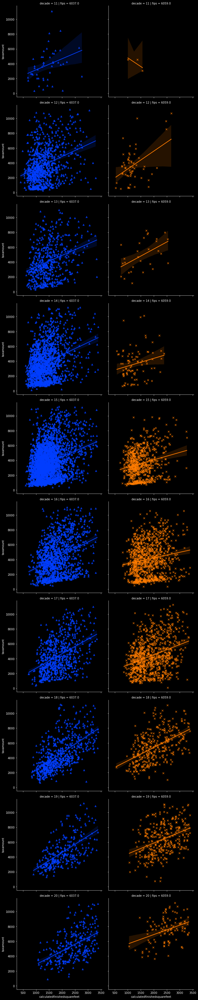

In [52]:
for i in num_2_combs:
    sns.lmplot(x=i[0], y=i[1],ci=95,scatter=True, data=df, row='decade', col='fips',hue='fips',markers=['^','x'])
    plt.show()


In [ ]:
# for i in num_2_combs:
#     sns.relplot(x=i[0], y=i[1],ci=95, data=df,kind='line', row='bedroomcnt', col='decade',hue='fips',markers=['o','x'])
#     plt.show()




Discrete with Continuous

Seaborn swarmplot or stripplot to examine a discrete variable by a continuous.

Seaborn boxplot, violinplot, or barplot to show the distribution of a continuous variable by a discrete variable.

We see that taxamount and tax valuedollarcnt are highly correlated so we will need to drop one later before we do our regression

In [ ]:

# for i in cat_v_num:
#     sns.swarmplot(x=i[0], y=i[1], data=df)
#     plt.show()



In [ ]:
# for i in cat_v_num:
#     sns.stripplot(x=i[0], y=i[1], data=df)
#     plt.show()


continuous variable by a discrete 

In [ ]:
# for i in num_v_cat:
#     sns.boxplot(x=i[0], y=i[1], data=df)
#     plt.show()



In [ ]:
# for i in num_v_cat:
#     sns.violinplot(x=i[0], y=i[1], data=df)
#     plt.show()  



In [ ]:
# for i in num_v_cat:
#     sns.barplot(x=i[0], y=i[1], data=df)
#     plt.show()




Discrete with Discrete

Seaborn heatmap with a pandas crosstab to examine discrete variables with discrete.